In [25]:
#libraries

import nltk
import warnings
import wordcloud
import pandas as pd
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from nltk.corpus import stopwords
from wordcloud import WordCloud, STOPWORDS
from deep_translator import GoogleTranslator
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from sentence_transformers import SentenceTransformer
import numpy as np
from sklearn.cluster import KMeans, AgglomerativeClustering
from sumy.summarizers.lex_rank import LexRankSummarizer
from sumy.nlp.tokenizers import Tokenizer
from sumy.parsers.plaintext import PlaintextParser

warnings.filterwarnings('ignore')
nltk.download('stopwords')
nltk.download('vader_lexicon')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\bioco\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\bioco\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\bioco\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [2]:
sid = SentimentIntensityAnalyzer()

In [13]:
data = pd.read_csv("https://raw.githubusercontent.com/jrobledob/R2M_Colombia_banana_and_plantain/main/Data/DATA_Focus_Group_Discussions_Likert_Scale_2023_12_08.csv")
data = data[['question_number','Open-ended',"Group","Question_text"]]
df_total = data.fillna('No sabe') #Change NA data with "I don't know"

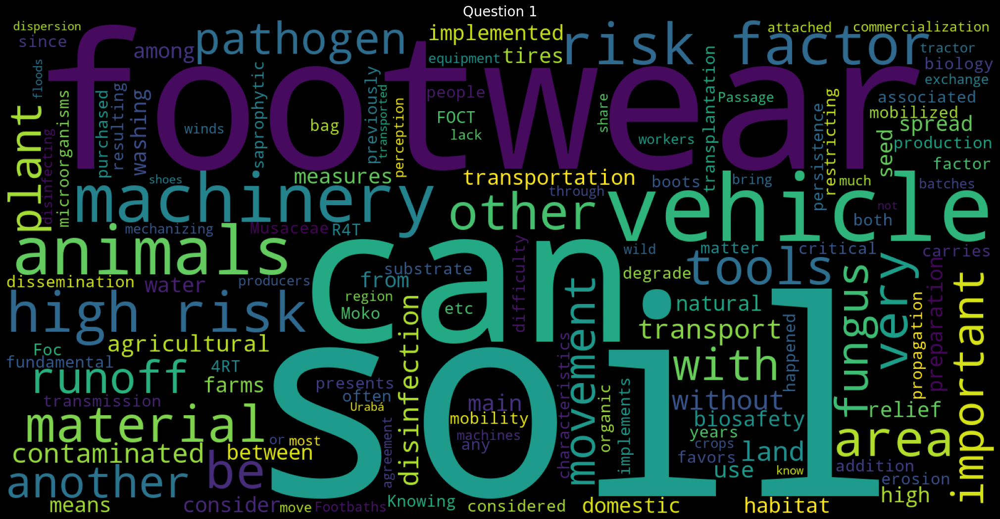

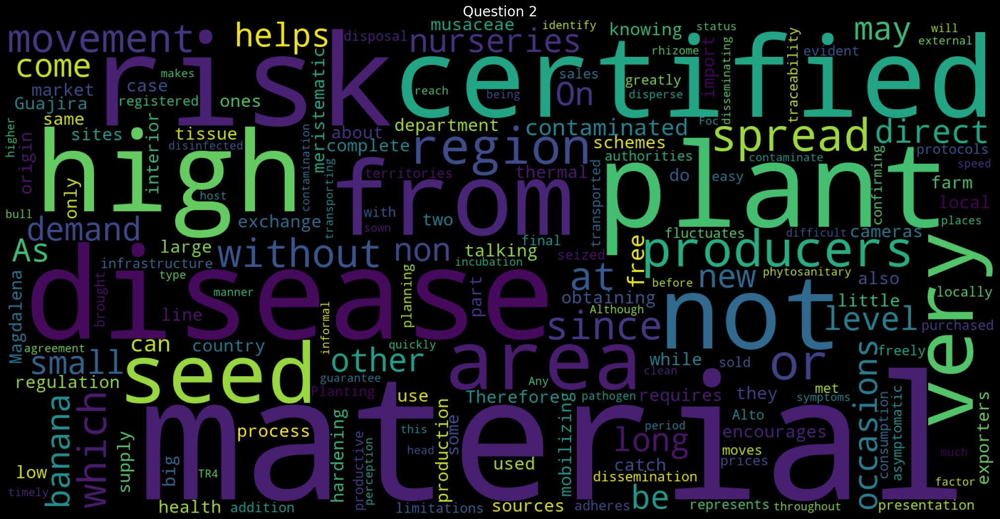

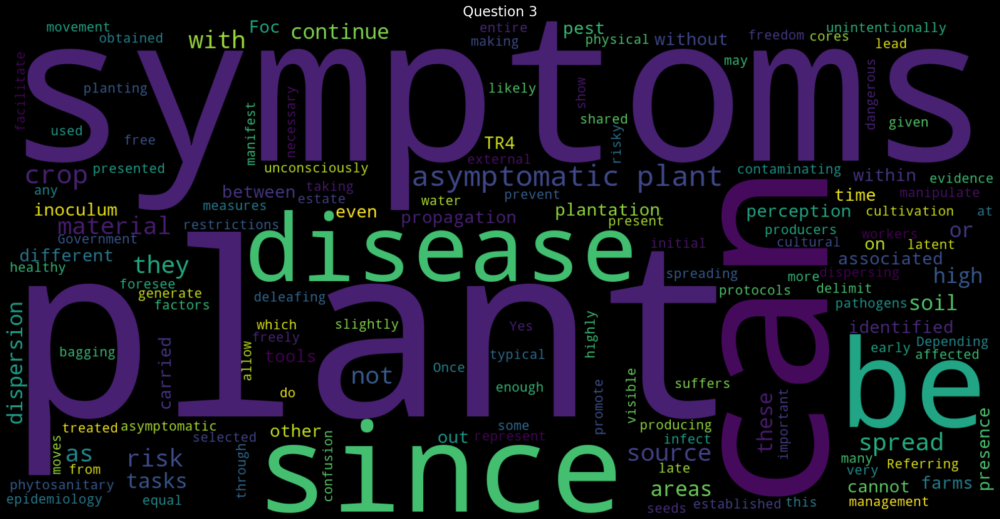

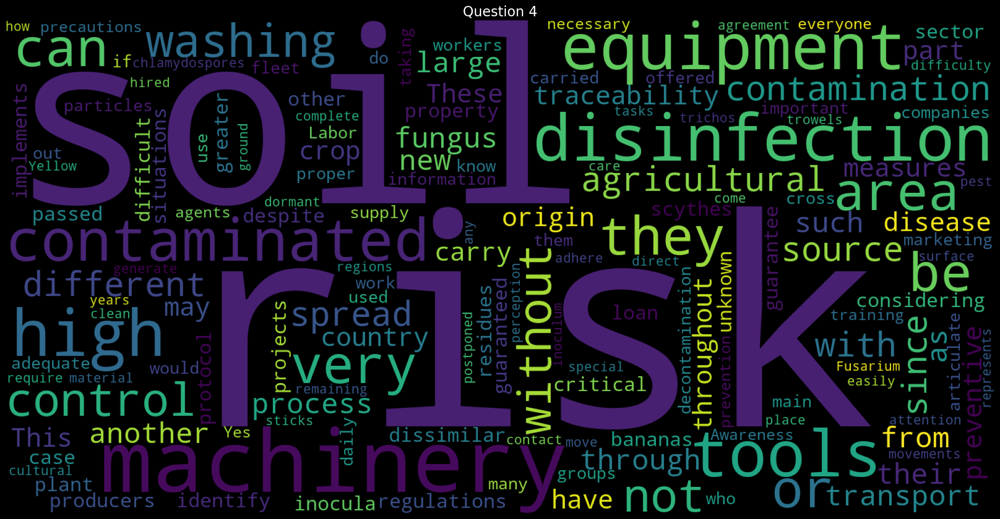

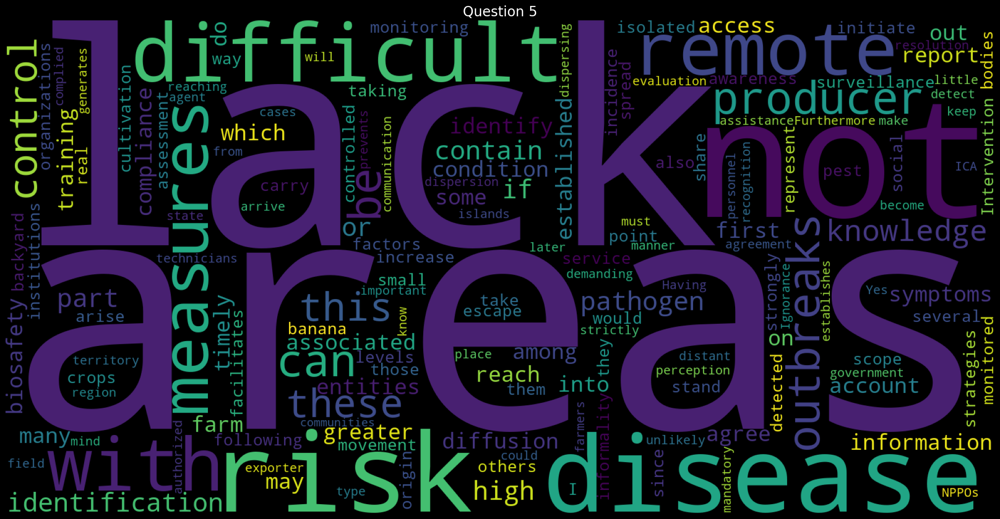

...

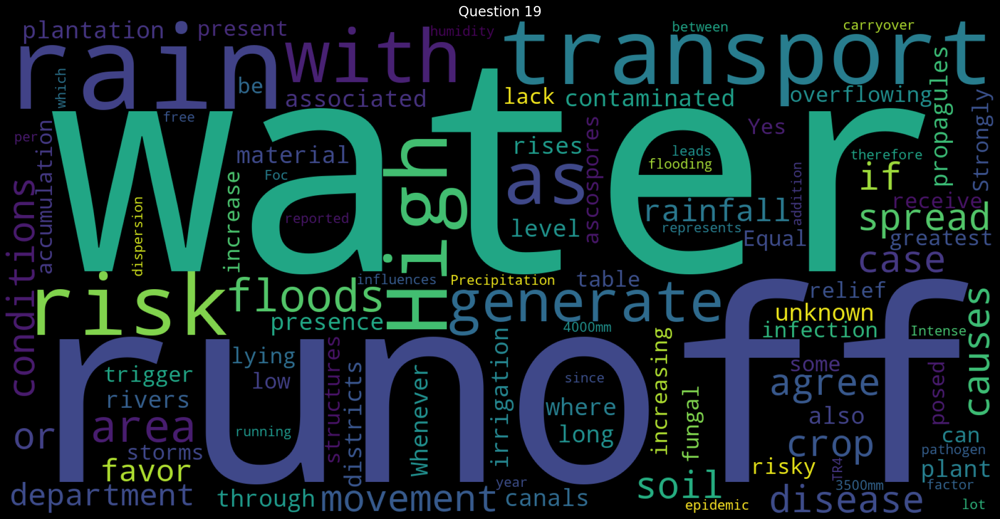

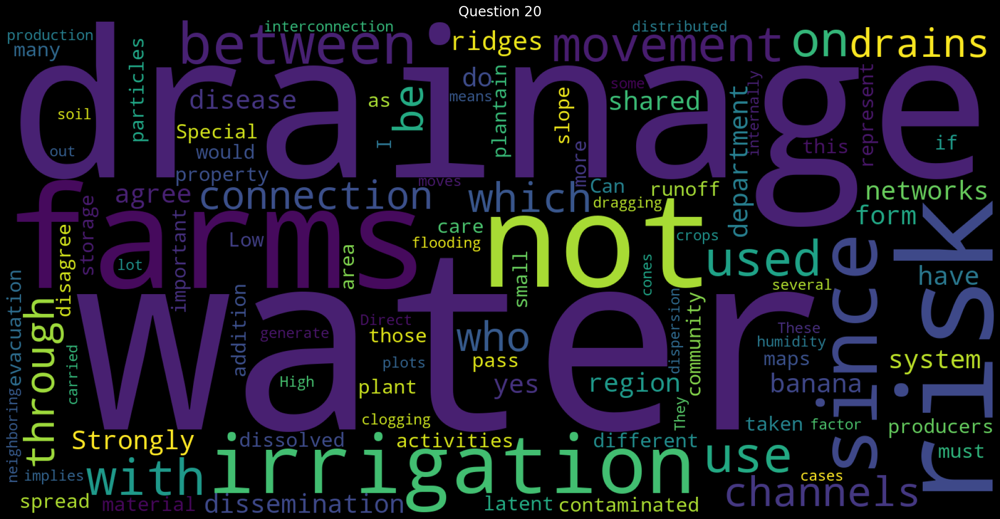

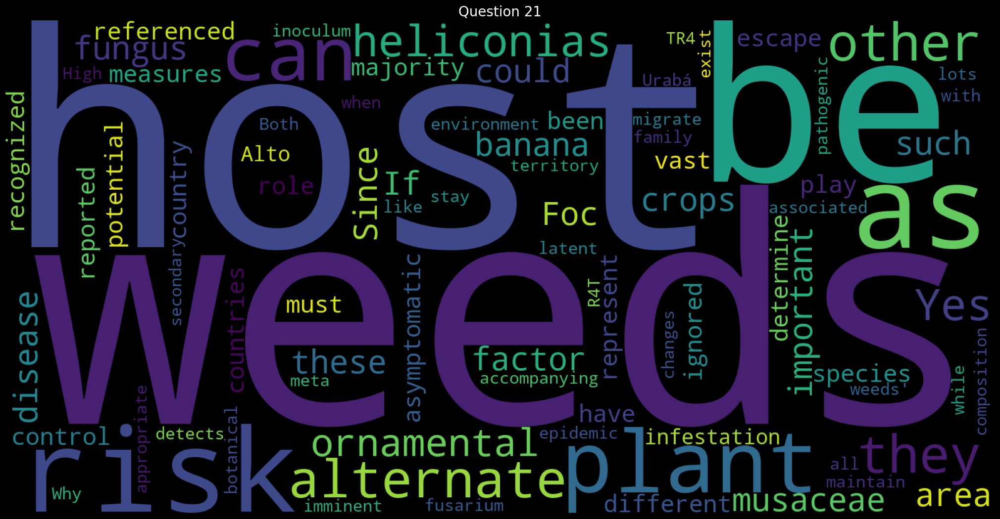

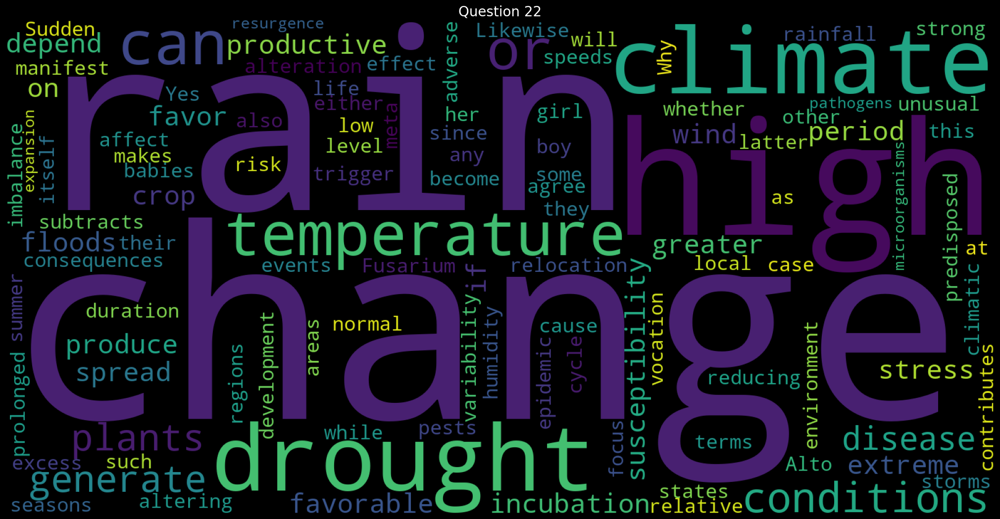

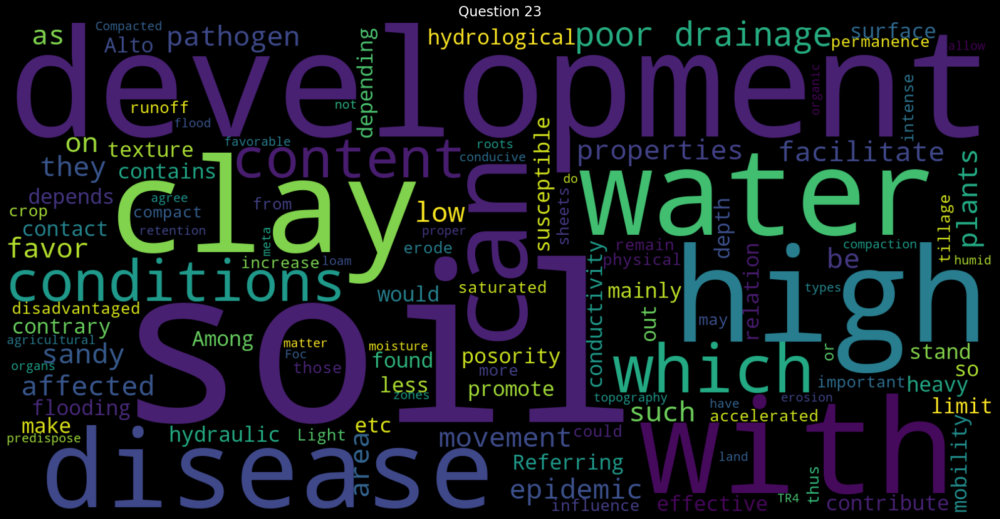

In [14]:
for question in df_total['question_number'].unique():
    dat = df_total.loc[df_total['question_number']==question]
    dat = dat[['Open-ended']]
    for i in dat.columns:
        for j in range(((len(dat)))):
            dat[i].iloc[j] = GoogleTranslator(source='auto', target='en').translate(dat[i].iloc[j])
    data_cloud = dat.reset_index(drop= True)
    data_c = []
    for i in data_cloud.columns:
        if data_cloud[i].isnull().values.any():
            continue
        text = " ".join(j for j in data_cloud[i])
        data_c.append(text)
    text = " ".join(j for j in data_c)
    stopwords_1 = set(stopwords.words('spanish', 'english'))
    stopwords_1.update([ 'the', 'It','that','in','is','and','for','by','because','are','due','our','its','an','we','Does','example','one','of','to','there'])
    wordcloud = WordCloud( stopwords = stopwords_1,width=1600, height=800, random_state=42).generate(text)
    plt.figure( figsize=(20,10), facecolor='k')
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout(pad=0)
    plt.title(f'Question {question}', color='white', fontsize=20)
    plt.show()

In [31]:
#Data_n = df_total.pivot(index="Question_text",columns="Group",values="Open-ended").reset_index()
Data_n = df_total.pivot(index="question_number",columns="Group",values="Open-ended").reset_index()
questions = df_total['Question_text'].iloc[0:23]
Data_n = pd. concat([pd.DataFrame(questions),Data_n], axis=1)
Data_n

,Question_text,question_number,1,2,3,4,5,6,7,8,9,10,11,12,13,14
0,1. El movimiento de suelo contaminado es u...,1,El suelo es considerado el principal factor de...,Conocedores de que el suelo es el hábitat natu...,El movimiento de suelo es el principal vehicul...,Alto ya que el suelo es critico y fundamental ...,Es UN factor de riesgo importante entre otros ...,Transporta patogenos,El suelo si es un factor de riesgo muy alto ta...,Se compra material de propagacion de musaceas ...,"En la preparación de suelos, preparación sin d...",El movimiento de suelo contaminado lo consider...,Nuestra percepción es muy de acuerdo debido a ...,"Es un factor de riesgo alto, es un hongo del ...","Alto, debido a que el suelo es el hábitat natu...",No sabe
1,2. El movimiento de plantas contaminadas (...,2,Siempre y cuando hablemos de pequeños producto...,A nivel de grande productores/ exportadores el...,No se cuenta con sitios certificados para la o...,Alto,Material de siembra SE mueve libremente en Los...,Porque se adhiere y ayuda a su facil diseminacion,"El riesgo es muy alto, se pueden estar transpo...",Se compra material no certificado y se trae ma...,Todo marial contaminado es un alto riesgo de c...,El movimiento de material contaminado es un fa...,Nuestra percepción es muy de acuerdo ya que pu...,Es un riesgo alto por la diseminación de la en...,"Alto, debido a que el periodo de incubación de...",Muy alto porque transportando y diseminando el...
2,3. Plantas asintomáticas dentro del cultiv...,3,Refiriéndonos a plantas sin presencia de sínto...,Una vez que hay una planta asintomática hay li...,Segun la epidemiologia de la enfermedad alguna...,Alto ya que puedo ser foco de dispersion de la...,La percepcion de riesgo es alta porque El mate...,Si porque existe patogenos que en cualquier mo...,Las plantas asintomaticas facilitan la dispers...,Una planta asintomatica sigue siendo fuente de...,En la plantación existen plantas asintomáticas...,Las plantas asintomáticas representan un riesg...,Nuestra percepción es que una planta asintomát...,Es un riesgo alto ya que no permite identifica...,Esas plantas al no presentar síntomas son una ...,Son altamente riesgosas ya que no pueden prev...
3,4. Movimiento de equipos agrícolas contami...,4,Pueden transportar inóculos del hongo a través...,Identificamos riesgo en el préstamo de maquina...,Una de las principales fuentes de contaminació...,Alto ya que si no se realiza una adecuada desi...,En muchas zonas la oferta de Mano de obra SE o...,Si porque las clamidosporas se adhieren facilm...,"El riesgo es muy alto, alla puede venir la fue...",Porque los equipos agricolas transportan suelo...,Estos movimientos de equipos contaminados gene...,Los equipos agrícolas contaminados diseminan l...,Nuestra percepción es totalmente de acuerdo ya...,Riesgo alto en estos equipos agrícolas pueden ...,La maquinaria amarilla representa un riesgo mu...,Es de esta forma como se propagan por las dife...
4,5. La presencia de pequeños focos de Foc-R...,5,Debido a que estas áreas pueden escapar del al...,Estamos de acuerdo y varios niveles a tener en...,"Porque se tienen muchos factores asociados, en...",Alto ya que si no existe como poder llegar ell...,Es de alto riesgo igualmente porque puede ser ...,Porque no son vigilados y no reportan a las in...,"Muy de acuerdo, esta condicion facilita el aum...","Si no se detecta, no se controla y hay mayor r...",No sabe,En las zonas remotas es poco posible que entid...,Nuestra percepción es de acuerdo debido a que ...,"Si, en estas áreas remotas de difícil acceso ...",Al tener focos en áreas remotas impide que los...,El desconocimiento y el difícil acceso a estas...
5,6. Foc-R4T puede ser transportado por el a...,6,El agua es una fuente altamente efectiva en la...,"Por un lado, las fuentes hídricas tanto magdal...",Se debe a varios factores al momento de identi...,Alto se debe tener un control en el manejo de ...,En Las zonas donde llegan aguas de escorrentia...,El patogeno sobrevive en 

In [37]:
for question in Data_n['question_number'].unique():
    dat = Data_n.loc[Data_n['question_number']==question]
    for index, row in dat.iterrows():
        anchor_phrase = row['Question_text']
        candidate_phrases = row[[1, 2, 3,4,5,6,7,8,9,10,11,12,13,14]].tolist()
        embedder = SentenceTransformer('bert-base-nli-mean-tokens')
        def manhattan_distance(x, y):
            return np.sum(np.abs(x - y))
        embeddings = embedder.encode([anchor_phrase] + candidate_phrases)
        anchor_embedding = embeddings[0]
        candidates = list(zip(candidate_phrases, embeddings[1:]))
        candidates = [(x[0], manhattan_distance(anchor_embedding, x[1])) for x in candidates]
        candidates = pd.DataFrame(candidates).sort_values(by=1, ascending=True).head(5)
        candidates = candidates[0].tolist()
        print(f'Question {question}:{candidates}')

Question 1:['En la preparación de suelos, preparación sin desinfección de implementos muchas veces proviniendo de  mecanizar lotes contaminados (desinfección de equipos)\n\n*Pediluvios ', 'El suelo es considerado el principal factor de diseminación para Foc R4T.   Se asocia al uso de maquinaria y herramientas agrícolas, calzado, trasplante de material vegetal,  transporte por aguas de escorrentía, entre otras', 'El suelo si es un factor de riesgo muy alto tanto en transporte de material vegetal, como suelo en calzado y llantas de vehiculos ', 'Es UN factor de riesgo importante entre otros por El relieve de la zona, la dificultad para restringir la movilidad de personas, vehiculos y animales. El relieve favorece la erosion y El movimiento de suelo contaminado a otras zonas. Ha pasado previamente con Moko en la zona.', 'Alto, debido a que el suelo es el hábitat natural del hongo y es uno de los medios de dispersión más importantes.\n En Urabá el suelo s puede ser transportado por llantas

In [59]:

np.random.seed(123)

for question in Data_n['question_number'].unique():
    dat = Data_n.loc[Data_n['question_number']==question].drop('question_number', axis=1)
    embedder = SentenceTransformer("all-MiniLM-L6-v2")
    for index, row in dat.iterrows():
        corpus = row[[1, 2, 3,4,5,6,7,8,9,10,11,12,13,14]].tolist()
    corpus_embeddings = embedder.encode(corpus)
    num_clusters = 5
    clustering_model = KMeans(n_clusters=num_clusters)
    clustering_model.fit(corpus_embeddings)
    cluster_assignment = clustering_model.labels_
    clustered_sentences = [[] for i in range(num_clusters)]
    for sentence_id, cluster_id in enumerate(cluster_assignment):
        clustered_sentences[cluster_id].append(corpus[sentence_id])
    print(f'Question {question}:')
    for i, cluster in enumerate(clustered_sentences):
        print("Cluster ", i + 1)
        print(cluster)
        print("")

Question 1:
Cluster  1
['No sabe']

Cluster  2
['El movimiento de suelo es el principal vehiculo de transmisión de microorganismos de un área a otra, en su bilogia el hongo presenta caracteristicas saprofitas que degradan la materia orgánica. ', 'Se compra material de propagacion de musaceas en bolsa (el sustrato es alto riesgo)\n\nEl transporte de suelo en vehiculos, calzado, etc\n\nNo se tienen implementadas medidas de bioseguridad', 'Nuestra percepción es muy de acuerdo debido a la falta de medidas de bioseguridad implementadas en los cultivos de la región por ejemplo la tierra que puede transportar el calzado la tierra que puede transportar un tractor u otra maquinaria agrícola la que puede traer una semilla. ']

Cluster  3
['El suelo es considerado el principal factor de diseminación para Foc R4T.   Se asocia al uso de maquinaria y herramientas agrícolas, calzado, trasplante de material vegetal,  transporte por aguas de escorrentía, entre otras', 'Conocedores de que el suelo es el

In [60]:
for question in Data_n['question_number'].unique():
    data_c = []
    dat = Data_n.loc[Data_n['question_number']==question].drop('question_number', axis=1)
    dat = dat.drop('Question_text',axis=1)
    for i in dat.columns:
        if dat[i].isnull().values.any():
            continue
        text = " ".join(j for j in dat[i])
        data_c.append(text)
    text = " ".join(j for j in data_c)
    parser = PlaintextParser.from_string(text, Tokenizer("spanish"))
    summarizer = LexRankSummarizer()
    summary = summarizer(parser.document, 5)
    print(f'Question {question}:')
    for sentence in summary:
        print(sentence)

Question 1:
Se asocia al uso de maquinaria y herramientas agrícolas, calzado, trasplante de material vegetal,  transporte por aguas de escorrentía, entre otras Conocedores de que el suelo es el hábitat natural del patógeno y que este se puede movilizar por medio de maquinaria, material vegetal, botas, herramientas, animales consideramos que el suelo es un muy importante factor de riesgo para propagación de FOCT 4RT- además ell patógeno tiene persistencia de 30 años en el suelo El movimiento de suelo es el principal vehiculo de transmisión de microorganismos de un área a otra, en su bilogia el hongo presenta caracteristicas saprofitas que degradan la materia orgánica.
Alto ya que el suelo es critico y fundamental para cualquier produccion Es UN factor de riesgo importante entre otros por El relieve de la zona, la dificultad para restringir la movilidad de personas, vehiculos y animales.
*Pediluvios  El movimiento de suelo contaminado lo consideramos de muy alto riesgo debido a que los p